## Extracting dominant colors  from an image

In [1]:
# using Pkg
# Pkg.add("Clustering")
# Pkg.add("Suppressor")
# Pkg.add("HTTP")
# Pkg.add("Images")
# Pkg.add("ImageMagick")
# Pkg.add("Cascadia")
# Pkg.add("Gumbo")

In [2]:
using Clustering, Suppressor, Plots
using HTTP, Images, Random
using Gumbo, Cascadia, Base64, ImageMagick

┌ Info: Precompiling Gumbo [708ec375-b3d6-5a57-a7ce-8257bf98657a]
└ @ Base loading.jl:1273
┌ Info: Precompiling Cascadia [54eefc05-d75b-58de-a785-1a3403f0919f]
└ @ Base loading.jl:1273


In [3]:
using Plots.PlotMeasures

We will use _[k-means](https://en.wikipedia.org/wiki/K-means_clustering)_ in the **[RGB space](https://en.wikipedia.org/wiki/Color_spaces_with_RGB_primaries)** as way a to find the most common colors in a picture. Clusters with the largest amount of elements will correspond to the dominant colors. In **[Julia](https://julialang.org/)** this is done with the following simple function. 

In [4]:
function thiefcolors(image; ncolors = 5)
    img_CHWa = channelview(image)
    img_CHW = permutedims(img_CHWa, (1,3,2))
    testmat = reshape(img_CHWa, (3, size(image)[1]*size(image)[2])) # proper input shape
    sol = kmeans(testmat, ncolors)
    csize = counts(sol) # get the cluster sizes
    colores = sol.centers # get the cluster centers, dominat colors
    indxc = sortperm(csize)
    colores, indxc
end

thiefcolors (generic function with 1 method)

For testing we will use images directly from ulr links. First example, 

In [5]:
url = "https://images.wallpaperscraft.com/image/autumn_drawing_walking_82963_320x480.jpg"
imgtest = HTTP.download(url)
imgtest = RGB.(load(imgtest));

┌ Info: Downloading
│   source = https://images.wallpaperscraft.com/image/autumn_drawing_walking_82963_320x480.jpg
│   dest = /var/folders/jr/9ds1d57s08j2dhr6rf6gf4q80000gp/T/autumn_drawing_walking_82963_320x480.jpg
│   progress = 1.0
│   time_taken = 0.03 s
│   time_remaining = 0.0 s
│   average_speed = 1.788 MiB/s
│   downloaded = 51.278 KiB
│   remaining = 0 bytes
│   total = 51.278 KiB
└ @ HTTP /Users/lalonso/.julia/packages/HTTP/GkPBm/src/download.jl:119


In [10]:
img_CHWa = channelview(imgtest)
img_CHW = permutedims(img_CHWa, (1,3,2))
testmat = reshape(img_CHWa, (3, size(imgtest)[1]*size(imgtest)[2]))

3×153600 reshape(reinterpret(N0f8, ::Array{RGB{N0f8},3}), 3, 153600) with eltype Normed{UInt8,8}:
 0.204  0.141  0.251  0.255  0.2    …  0.118  0.145  0.165  0.173  0.176
 0.216  0.145  0.239  0.235  0.169     0.02   0.024  0.027  0.027  0.02 
 0.58   0.506  0.58   0.557  0.471     0.035  0.047  0.055  0.059  0.055

Retrieving colors... 

In [11]:
Random.seed!(1021)
colores, indxc = thiefcolors(imgtest);

┌ Warning: The clustering cost increased at iteration #49
└ @ Clustering /Users/lalonso/.julia/packages/Clustering/dzWhx/src/kmeans.jl:188
┌ Warning: The clustering cost increased at iteration #53
└ @ Clustering /Users/lalonso/.julia/packages/Clustering/dzWhx/src/kmeans.jl:188
┌ Warning: The clustering cost increased at iteration #55
└ @ Clustering /Users/lalonso/.julia/packages/Clustering/dzWhx/src/kmeans.jl:188
┌ Warning: The clustering cost increased at iteration #58
└ @ Clustering /Users/lalonso/.julia/packages/Clustering/dzWhx/src/kmeans.jl:188
┌ Warning: The clustering cost increased at iteration #59
└ @ Clustering /Users/lalonso/.julia/packages/Clustering/dzWhx/src/kmeans.jl:188
┌ Warning: The clustering cost increased at iteration #60
└ @ Clustering /Users/lalonso/.julia/packages/Clustering/dzWhx/src/kmeans.jl:188


In [12]:
colores

3×5 Array{Float32,2}:
 0.441495  0.313739  0.82619   0.737212  0.268337
 0.659185  0.35011   0.429473  0.924389  0.119238
 0.826454  0.475061  0.172724  0.93226   0.135856

Plotting the image and the first 5 dominant colors we get the following: 

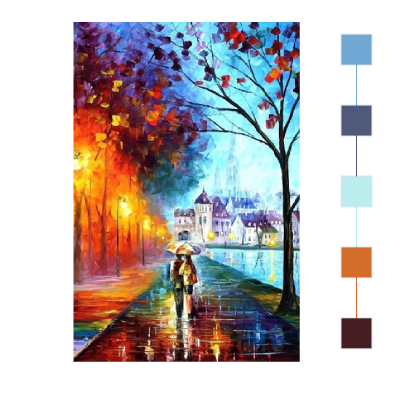

In [7]:
plot(imgtest, aspect_ratio = 1, grid = false, 
    axis = :off, size = (400, 400))
plot!(fill(400, 5), collect(0:100:400) .+ 40, m = (:rect,15,stroke(0.1)),
    c = [RGB(colores[:,indxc[i]]...) for i in 1:5], leg = false)
#savefig("fig1.png")

In [8]:
RGB(colores[:,indxc[1]]...)

### And for more images this looks as follows... 

In [9]:
urlinks = ["https://images.wallpaperscraft.com/image/man_paint_sky_129261_320x480.jpg",
    "https://images.wallpaperscraft.com/image/zhang_bin_girl_art_wind_100944_320x480.jpg",
    "https://images.wallpaperscraft.com/image/girl_art_brush_128328_320x480.jpg",
    "https://images.wallpaperscraft.com/image/landscape_art_moon_127187_320x480.jpg",
    "https://images.wallpaperscraft.com/image/landscape_art_trees_132641_320x480.jpg", 
    "https://images.wallpaperscraft.com/image/kimi_no_tonari_de_koishiteru_hoshino_nagisa_girl_school_uniform_101974_320x480.jpg", 
    "https://images.wallpaperscraft.com/image/girl_anime_sadness_127305_320x480.jpg",
    "https://images.wallpaperscraft.com/image/anime_girl_wings_angel_persons_profile_13291_320x480.jpg", 
    "https://images.wallpaperscraft.com/image/night_room_girls_friends_things_computer_drinks_lamp_shelves_tv_87239_320x480.jpg",
    "https://images.wallpaperscraft.com/image/bleach_naruto_naruto_vs_ichigo_crossover_naruto_shippuden_93631_320x480.jpg",
    "https://images.wallpaperscraft.com/image/silhouette_art_sky_129925_320x480.jpg", 
    "https://images.wallpaperscraft.com/image/anime_couple_love_bed_88134_320x480.jpg", 
    "https://images.wallpaperscraft.com/image/art_lm7_op_center_girl_katana_weapons_hat_smiley_anime_94028_320x480.jpg", 
    "https://images.wallpaperscraft.com/image/vocaloid_hatsune_miku_girl_microphone_tie_song_35368_320x480.jpg", 
    "https://images.wallpaperscraft.com/image/asuna_yuuki_sword_art_online_sword_art_online_ii_113741_320x480.jpg"];

#### Downloading images...

In [10]:
imgs = []
@suppress begin
    for i in 1:length(urlinks)
        img = HTTP.download(urlinks[i])
        push!(imgs, RGB.(load(img)))
    end
end

In [11]:
length(imgs)

15

### Extracting color and plotting... 

In [12]:
Random.seed!(1021)
imagenes = []
for indx in 1:15
    @suppress begin 
        global colores, indxc
        colores, indxc = thiefcolors(imgs[indx])
    end
    p = plot(imgs[indx], aspect_ratio = 1, grid = false, axis = :off, size = (300, 300))
    plot!(fill(400, 5), collect(0:100:400) .+ 40, m = (:rect,10, stroke(0.1)),
        c = [RGB(colores[:,indxc[i]]...) for i in 1:5], leg = false)
    push!(imagenes, p)
end


In [18]:
plot(imagenes..., layout = (3,5), left_margin = -10mm, size = (1000, 600))
#savefig("fig2.pdf")

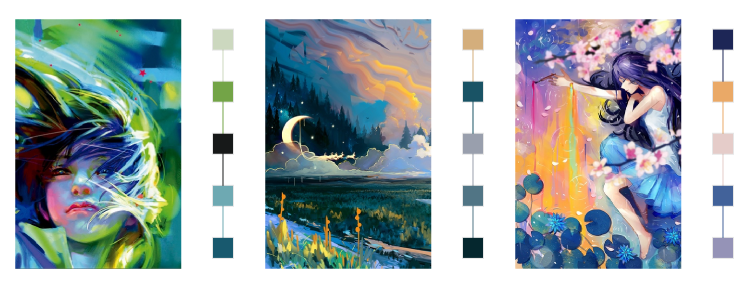

In [39]:
plot([imagenes[2], imagenes[4], imagenes[3]] ..., layout = (1,3), size = (750, 300))

Overall, all examples look good. 

## A simple application to ratings of anime
First, let's download some popular images from anime.

In [21]:
urlTop = [
    "https://images.wallpaperscraft.com/image/attack_on_titan_eren_jaeger_shingeki_no_kyojin_104200_320x480.jpg",
    "https://images.wallpaperscraft.com/image/fullmetal_alchemist_edward_alphonse_boys_blondes_pigeons_smiles_29947_320x480.jpg",
    "https://images.wallpaperscraft.com/image/naruto_uzumaki_naruto_ninja_113276_320x480.jpg",
    "https://images.wallpaperscraft.com/image/dragon_ball_z_goku_aggression_guy_102646_320x480.jpg",
    "https://images.wallpaperscraft.com/image/fairy_tail_loke_guy_glasses_107942_320x480.jpg",
    "https://images.wallpaperscraft.com/image/sword_art_online_yuuki_asuna_girl_elf_104363_320x480.jpg",
    "https://images.wallpaperscraft.com/image/bleach_ichigo_bankai_72081_320x480.jpg",
    "https://images.wallpaperscraft.com/image/code_geass_boy_girl_smile_costumes_27609_320x480.jpg",
    "https://images.wallpaperscraft.com/image/saipaco_makise_kurisu_girl_brunette_shirt_tie_shorts_35369_320x480.jpg",
    "https://images.wallpaperscraft.com/image/anime_blue_exorcist_ao_no_exorcist_rin_okumura_28370_320x480.jpg",
    "https://images.wallpaperscraft.com/image/death_note_boy_brunette_space_36764_320x480.jpg",
    "https://images.wallpaperscraft.com/image/chelsea_akame_ga_kill_anime_girl_face_102715_320x480.jpg",
    "https://images.wallpaperscraft.com/image/attack_of_the_titans_pokemon_pikachu_art_98697_320x480.jpg",
    "https://images.wallpaperscraft.com/image/inuyasha_kagome_girl_brunette_dream_tree_41238_320x480.jpg",
    "https://images.wallpaperscraft.com/image/girl_school_classroom_desk_briefcase_smile_12112_320x480.jpg",
    "https://images.wallpaperscraft.com/image/one_punch_man_saitama_character_113257_320x480.jpg",
    "https://images.wallpaperscraft.com/image/fate_zero_boy_girl_walking_street_25212_320x480.jpg",
    "https://images.wallpaperscraft.com/image/elfen_lied_girl_jewelry_box_look_street_27850_320x480.jpg",
    "https://images.wallpaperscraft.com/image/evangelion_girl_sky_pose_costume_gesture_25523_320x480.jpg",
    "https://images.wallpaperscraft.com/image/fate_stay_night_girl_blond_nice_sword_25595_320x480.jpg"
];

downloading... 

In [22]:
imgsAnime = []
@suppress begin
    for i in 1:length(urlTop)
        img = HTTP.download(urlTop[i])
        push!(imgsAnime, RGB.(load(img)))
    end
end

In [23]:
length(imgsAnime)

20

and plotting... 

In [24]:
Random.seed!(1021)
imagenesAn = []
for indx in 1:20
    @suppress begin 
        global colores, indxc
        colores, indxc = thiefcolors(imgsAnime[indx])
    end
    p = plot(imgsAnime[indx], aspect_ratio = 1, grid = false, axis = :off, size = (300, 300))
    plot!(fill(400, 5), collect(0:100:400) .+ 40, m = (:d,10, stroke(0.1)),
        c = [RGB(colores[:,indxc[i]]...) for i in 1:5], leg = false)
    push!(imagenesAn, p)
end

In [25]:
plot(imagenesAn..., layout = (4,5), rigth_margin = -10mm, left_margin = -10mm, size = (1000, 900))
#savefig("fig3.png")

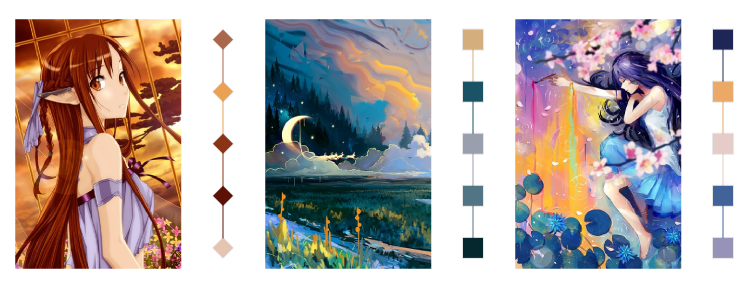

In [65]:
plot([imagenesAn[6], imagenes[4], imagenes[3]] ..., layout = (1,3), size = (750, 300))
#savefig("portada.png")

# Ratings... 
- https://www.imdb.com/list/ls021457150/

In [18]:
# fullmetal, one punch man, attack on titan, code geass, naruto, bleach , elfen lied, evangelion
indx_anime = [2, 16, 1, 8, 3, 7, 18, 19]
ratings = [9.1, 8.8, 8.8, 8.6, 8.5, 8.1, 8.0, 8.5];

Selecting 2 colors out of 5. The first and second most dominant colors. 

In [19]:
Random.seed!(1021)
picsRGBs = []
for indx in indx_anime
    @suppress begin
        colores, indxc = thiefcolors(imgsAnime[indx])
        push!(picsRGBs, [imgsAnime[indx], colores[:,indxc[4:5]]])
    end
end

In [20]:
cborders = [RGB(picsRGBs[i][2][:,2]...) for i in 1:length(picsRGBs)]
cfillrect = [RGB(picsRGBs[i][2][:,1]...) for i in 1:length(picsRGBs)];

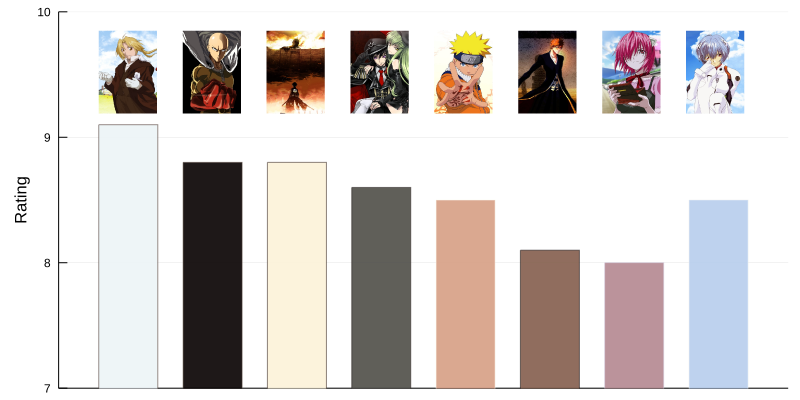

In [21]:
figura = plot(ratings, st = :bar, c = cfillrect, line = (0.5, cborders), bar_width = 0.7, alpha = 0.9,
    ylab = "Rating", xticks = false, leg =false, size = (800, 400),ylim = (7, 10))
xcor = 0.055
ycor = 0.05
for i in 1:8  
    plot!(picsRGBs[i][1], inset = [(1, bbox(xcor, ycor, 0.08, 0.22))], 
        subplot=i+1, axis =false, bg = :transparent)
    xcor += 0.17-0.055
end
figura
#savefig("fig4.png")

One you know how to do it, its simple. As a last example let's consider some emojis. 

### Emojis... dominant color and a little bit of web scrapping... 

Retriving all available emojis from web page... 

In [13]:
url = "https://unicode.org/emoji/charts/full-emoji-list.html"
response = HTTP.get(url)
html = response.body |> String |> parsehtml
elements = eachmatch(sel".imga", html.root);

Getting some at random.

In [14]:
function getemojis(elements; nemoji = 50)
    imgsarr = []
    for ele in elements[rand(1:length(elements), nemoji)]
        srcflor = ele.attributes["src"][23:end]
        img = srcflor |> base64decode |> readblob
        push!(imgsarr, img)
    end
    imgsarr
end

getemojis (generic function with 1 method)

In [15]:
Random.seed!(1234)
randemojis = getemojis(elements);

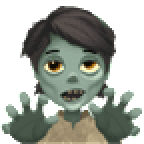

In [16]:
randemojis[11]

Note that all emojis have an alpha channel, which looks like a green color once we apply **RGB.** 

,,,,,,,
,,,,,,,
,,,,,,,
,,,,,,,
,,,,,,,

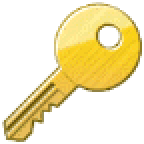
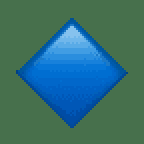
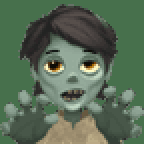
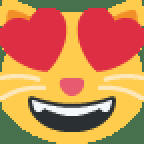
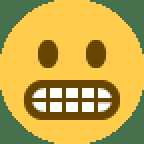
...
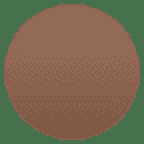
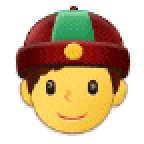
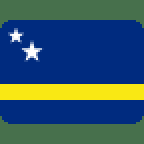
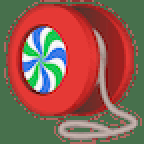
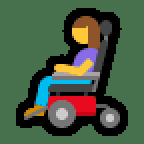

In [17]:
reshape([RGB.(randemojis[i]) for i in 1:40], (5,8))

Then, for 4 clusters we take the third most dominant color just to avoid the green one in most cases. There are clever ways to do it, but for now is ok. 

In [18]:
Random.seed!(12)
dominant = []
for i in 1:40
    colem, indxcem = thiefcolors(RGB.(randemojis[i]); ncolors = 4)
    push!(dominant, RGB(colem[:,indxcem[2]]...))
end

In [19]:
[dominant[i] for i in 1:40]